<a href="https://colab.research.google.com/github/nitingarg2015/EVA8/blob/master/Assignment%2012/Object%20detection%20using%20YoloV5/PPE_using_Yolov7.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Clone git repository: https://github.com/ultralytics/yolov5

In [1]:
!git clone https://github.com/ultralytics/yolov5  # clone

Cloning into 'yolov5'...
remote: Enumerating objects: 15352, done.
remote: Counting objects: 100% (17/17), done.
remote: Compressing objects: 100% (17/17), done.
remote: Total 15352 (delta 5), reused 4 (delta 0), pack-reused 15335
Receiving objects: 100% (15352/15352), 14.22 MiB | 19.92 MiB/s, done.
Resolving deltas: 100% (10525/10525), done.


# Mount Google Drive

In [2]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


## Copy custom dataset
Create folder "datasets" in the root directory. Unzip custom dataset into this directory

In [3]:
#copy custom data folder to data folder

zippath = "/content/gdrive/MyDrive/ColabNotebooks/Samplecodes/yolov4piford/data/cusdata.zip"

from zipfile import ZipFile

with ZipFile(zippath, 'r') as zip:
  zip.extractall("/content/datasets")
  print('Done')

Done


## Install Requirements

Change directory to yolov5 and install requirements

In [4]:
%cd yolov5
!pip install -r requirements.txt  # install

/content/yolov5
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 KB 5.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 7.6 MB/s eta 0:00:00


In [5]:
!pwd

/content/yolov5


## Custom train using yolov5m.pt weights

Make following changes in data/coco128.yaml
1. path: ../datasets/cusdata
2. train: images
3. val: images

classes: person, vest, red, blue, white, yellow (remove all other classes)

In [7]:
!python train.py --img 640 --epochs 50 --data coco128.yaml --weights yolov5m.pt

train: weights=yolov5m.pt, cfg=, data=coco128.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=50, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-131-g0c8de3f Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4,

##Copy trained best.pt to required folder
This was generated as part of above training run

In [6]:
#copy best weights file to runs/train/exp2/weights/
!cp /content/gdrive/MyDrive/ColabNotebooks/Samplecodes/YoloV3/best.pt /content/yolov5/runs/train/exp

## Make Predictions

In [9]:
!python detect.py --weights runs/train/exp/weights/best.pt --source /content/gdrive/MyDrive/ColabNotebooks/Samplecodes/YoloV3/testimages

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/gdrive/MyDrive/ColabNotebooks/Samplecodes/YoloV3/testimages, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-131-g0c8de3f Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 212 layers, 20873139 parameters, 0 gradients, 47.9 GFLOPs
image 1/16 /content/gdrive/MyDrive/ColabNotebooks/Samplecodes/YoloV3/testimages/ppe_1314.jpg: 448x640 2 persons, 2 whites, 22.9ms
image 2/16 /content/gdrive/MyDrive/ColabNotebooks/Samplecodes/YoloV3/testimages/ppe_1315.jpg: 640x448 2 persons, 1 white, 2 yellows, 21.9ms
image 3/16 /content/gdrive

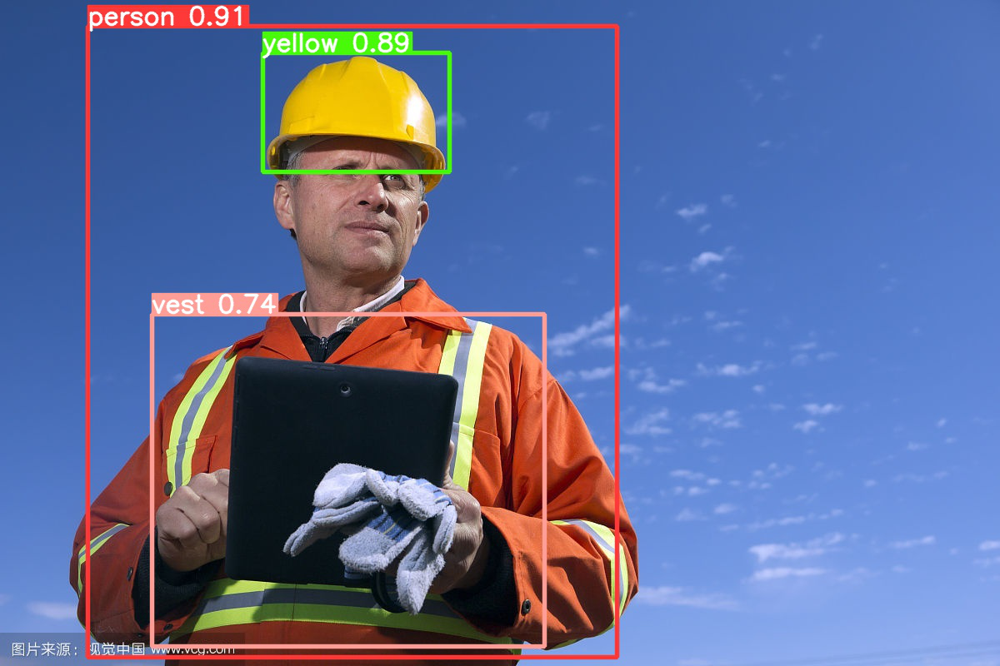

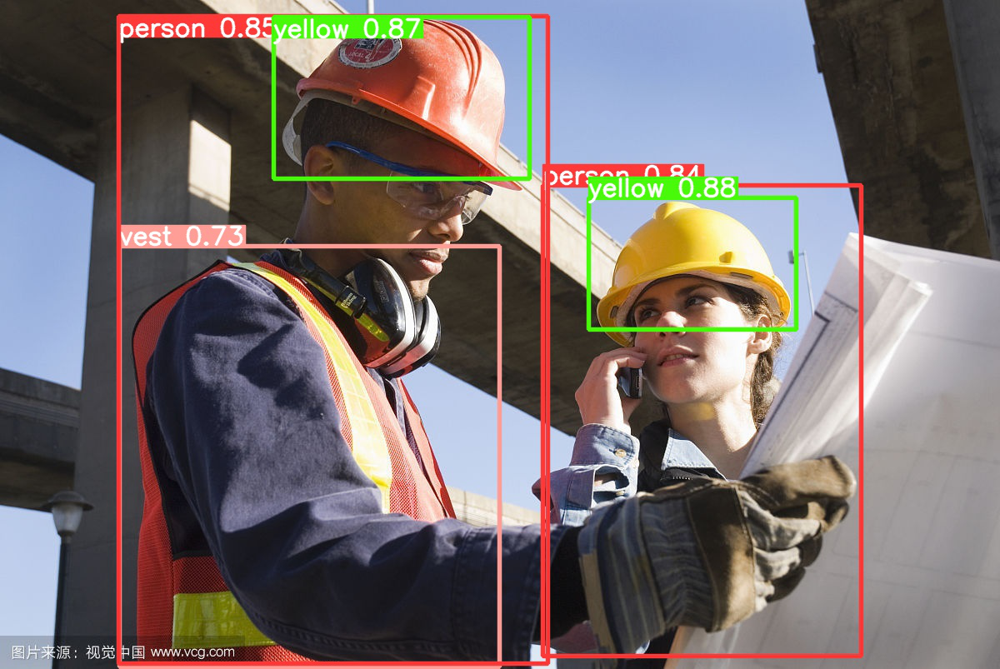

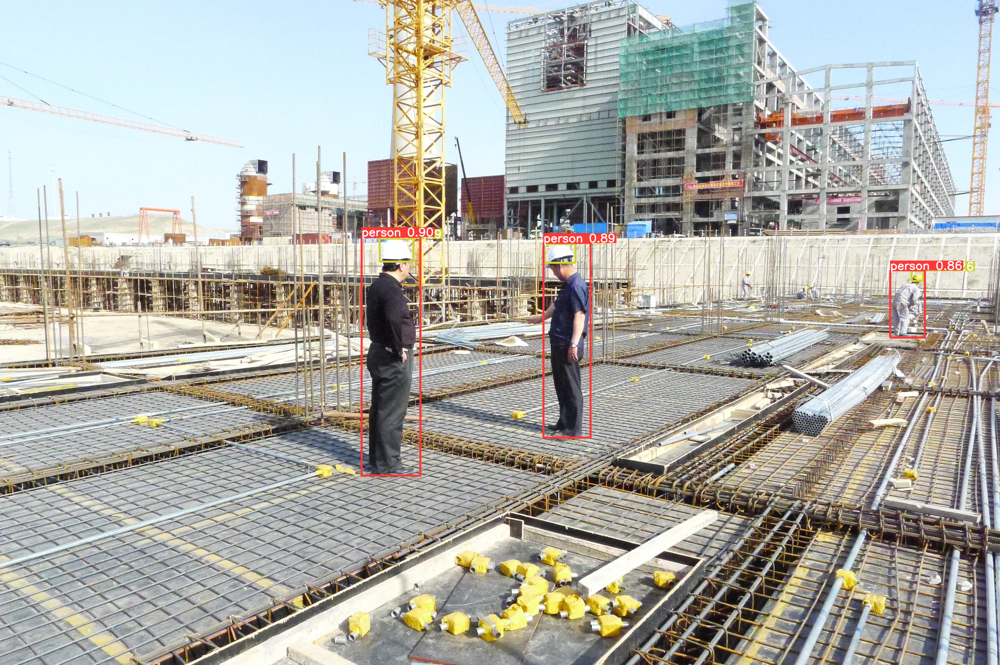

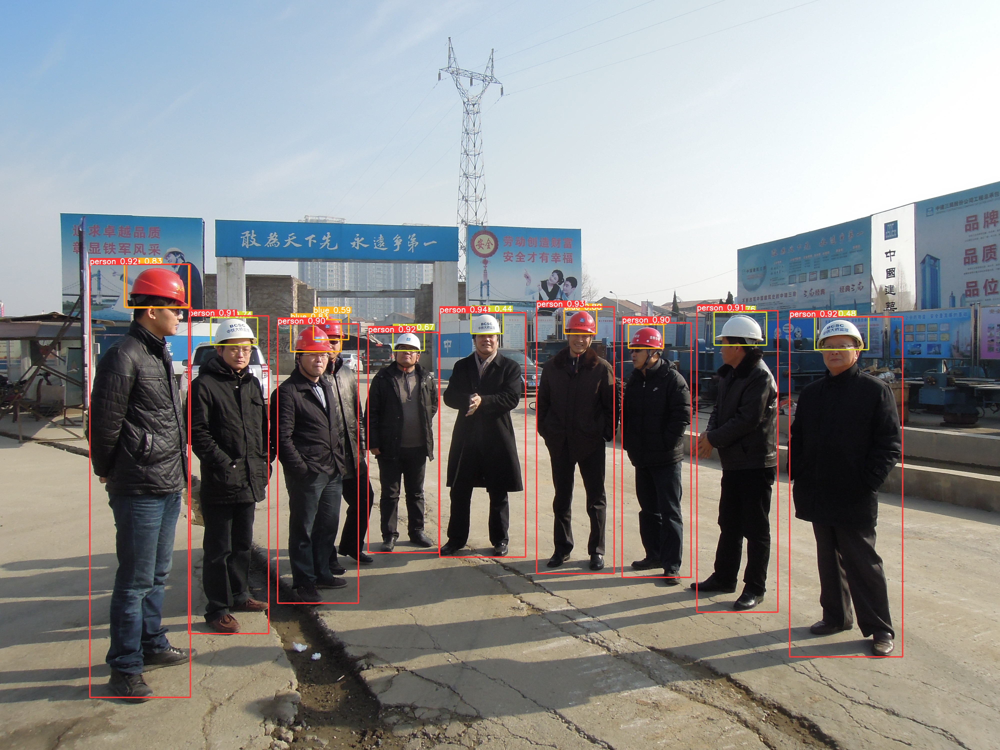

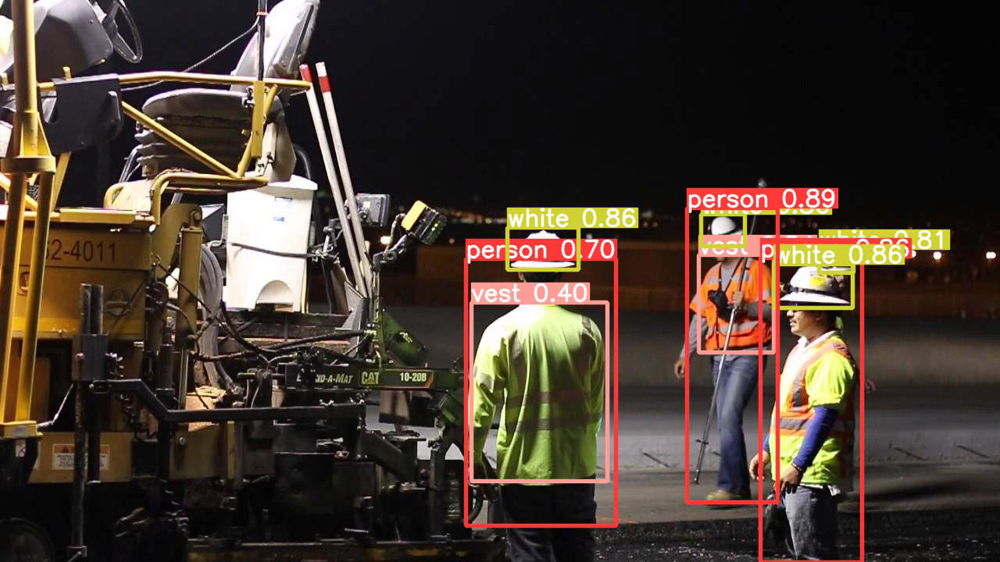

...

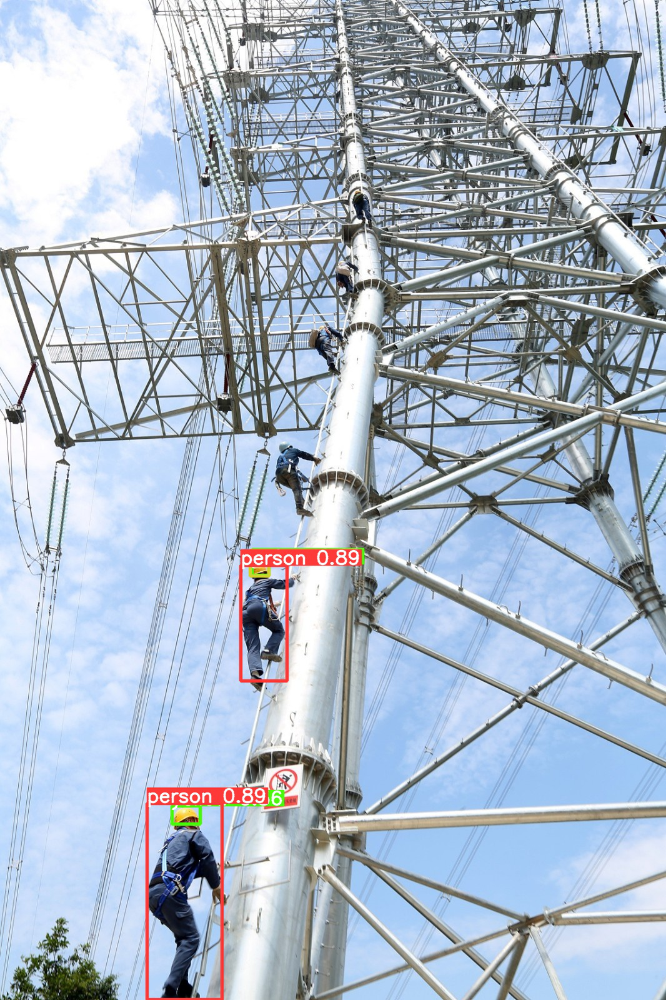

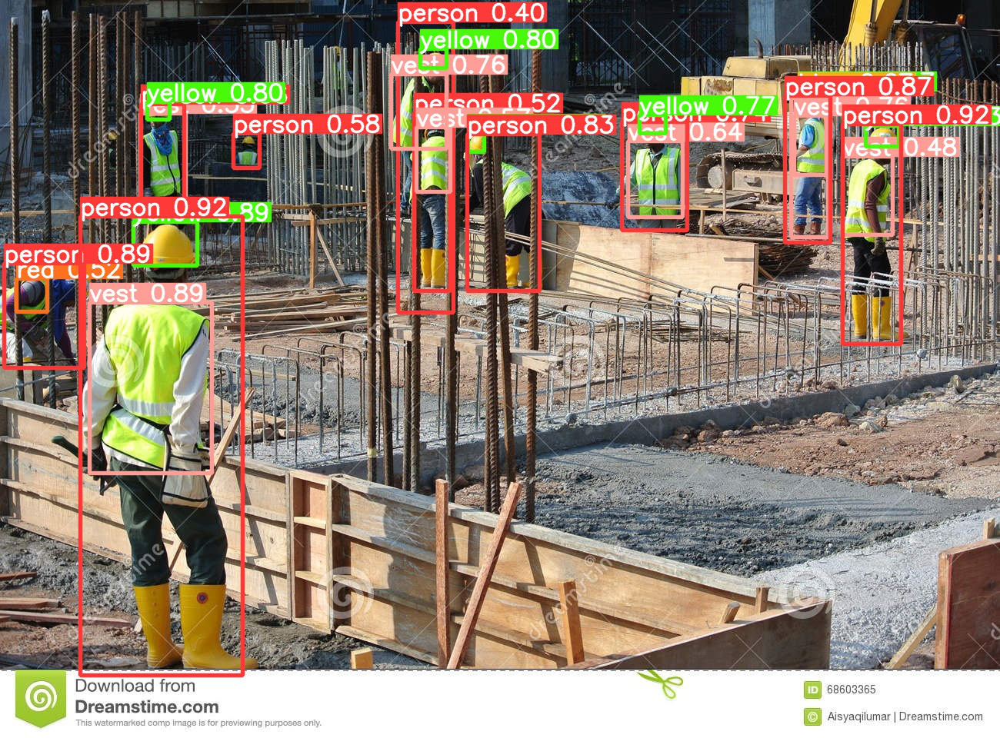

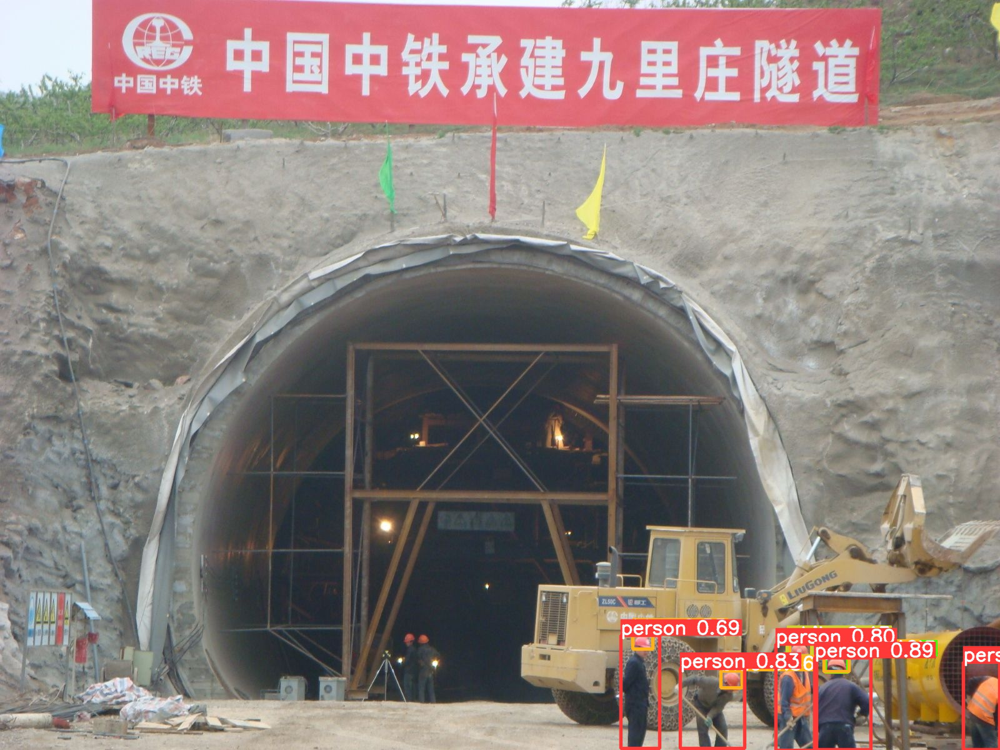

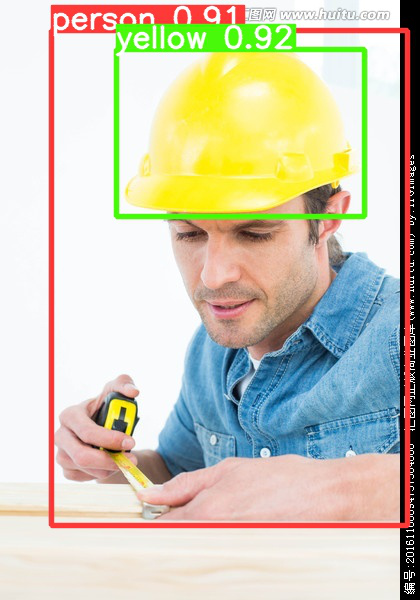

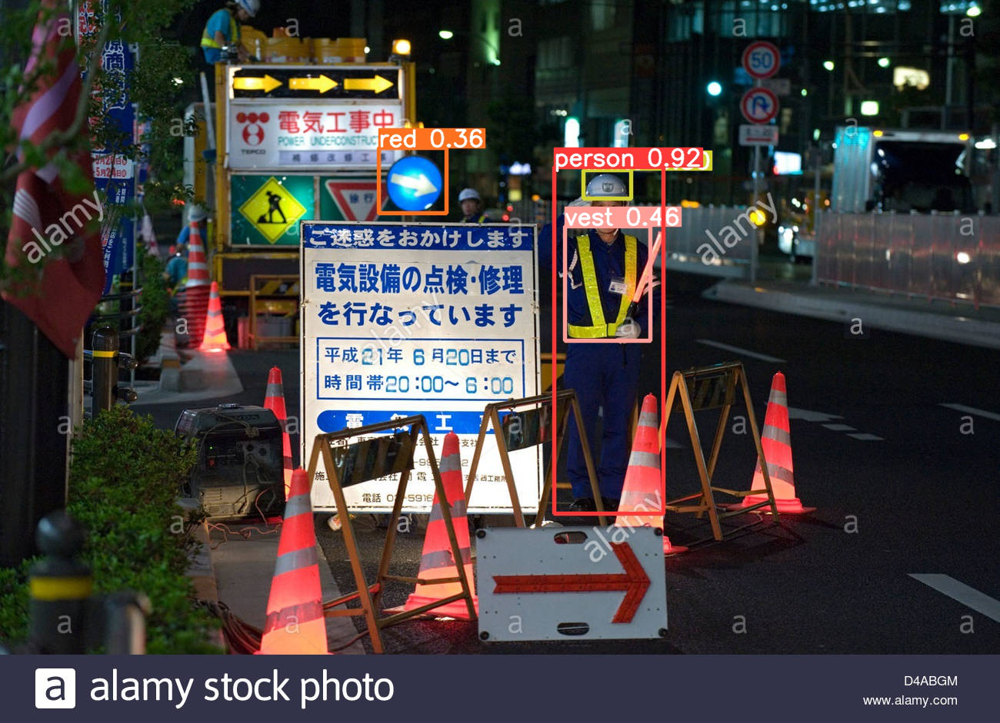

In [10]:
from PIL import Image
import os

folder_path = "/content/yolov5/runs/detect/exp3"

for filename in os.listdir(folder_path):
    image_path = os.path.join(folder_path, filename)
    img = Image.open(image_path)
    img.show()
